# **Table of Content:**

 
  <img  style="float: right;" align="left" width="30%"  src="../images/diamond.png">

- [Notebook Configuration (#)](#notebook-configuration----)
  * [Importing Libraries & Notebook Configuration](#importing-libraries---notebook-configuration)
  * [Importing Data and dataframe creation](#importing-data-and-dataframe-creation)
- [Basic Dataset Description](#basic-dataset-description)
  * [Shape, size and preview](#shape--size-and-preview)
  * [Categories and Types](#categories-and-types)
  * [Missing Values](#missing-values)
  * [Duplicated Values](#duplicated-values)
  * [Include Price by Carat Column](#include-price-by-carat-column)
  * [Description of Categories](#description-of-categories)
    + [Quantitative Overview](#quantitative-overview)
    + [Qualitative  Overview](#qualitative-overview)
  * [Correlation Matrix](#correlation-matrix)
- [Qualitative Variables](#qualitative-variables)
  * [General Description](#general-description)
  * [Cut Colum](#cut-colum)
  * [Clarity Column](#clarity-column)
  * [Color Column](#color-column)
- [Qualitative Variables](#qualitative-variables-1)
  * [General Description](#general-description-1)
  * [Carat Column](#carat-column)
  * [Depth Column](#depth-column)
  * [Table Column](#table-column)
  * [Price Column](#price-column)
  * [Dimensional Values](#dimensional-values)
  


-------------
-----------------

# **Notebook Configuration**

## **<span style="color:#0785A7"> Importing Libraries & Notebook Configuration**

In [53]:
# Working with Data
import pandas as pd
import numpy as np

# Data Viz
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import cufflinks as cf


In [54]:
# Plotting on Jupyter
cf.go_offline()
%matplotlib inline

## **<span style="color:#0785A7"> Importing Data and dataframe creation**

In [55]:
DATA_PATH = '../data/diamonds_train.csv'
df = pd.read_csv(DATA_PATH)

-------------
-----------------

# **<span style="color:Black"> Basic Dataset Description**

## **<span style="color:#0785A7">Shape, size and preview**

In [56]:
display(df.head())
print('\nShape and Size:')
print(f'Rows: {df.shape[0]}\n'+ 
      f'Cols: {df.shape[1]}\n'+
      f'Cels: {df.size}\n')

,carat,cut,color,clarity,depth,table,price,x,y,z
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95



Shape and Size:
Rows: 40455
Cols: 10
Cels: 404550



----



## **<span style="color:#0785A7">Categories and Types**

* **Carat:** Carat weight of the Diamond.
* **Cut:** Describe cut quality of the diamond.
* **Color:** Color of the Diamond.
* **Clarity:** Diamond Clarity refers to the absence of the Inclusions and Blemishes.
* **Depth:** The Height of a Diamond, measured from the Culet to the table, divided by its average Girdle Diameter.
* **Table:** The Width of the Diamond's Table expressed as a Percentage of its Average Diameter.
* **Price:** the Price of the Diamond.
* **X:** Length of the Diamond in mm.
* **Y:** Width of the Diamond in mm.
* **Z:** Height of the Diamond in mm.

In [57]:
num_cols = df.select_dtypes(include=['int','float']).columns.to_list()
cat_cols= [col for col in df.columns.to_list() if col not in num_cols]

print(f'{len(num_cols)} Numerical Categories: {num_cols}')
print(f'{len(cat_cols)} Categorical Categories: {cat_cols}')

7 Numerical Categories: ['carat', 'depth', 'table', 'price', 'x', 'y', 'z']
3 Categorical Categories: ['cut', 'color', 'clarity']


----



## **<span style="color:#0785A7">Missing Values**

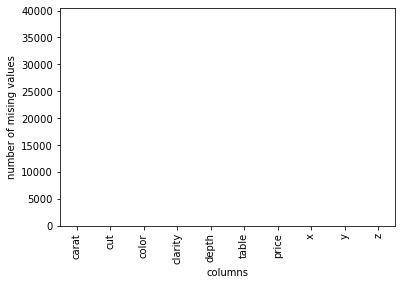

In [58]:
ax= df.isnull().sum().plot(kind='bar',ylim=(0,len(df)))
ax.set_ylabel('number of mising values')
ax.set_xlabel('columns');

----



## **<span style="color:#0785A7">Duplicated Values**

In [59]:
duplicated_df = df[df.duplicated(keep='first')]

print(f'There is {len(duplicated_df)} rows duplicated in this dataset')
duplicated_df.head()

There is 89 rows duplicated in this dataset


,carat,cut,color,clarity,depth,table,price,x,y,z
1951,1.30,Very Good,F,SI2,61.1,58.0,6149,6.98,7.02,4.28
3083,1.00,Fair,H,SI1,65.5,57.0,3511,6.26,6.21,4.08
5631,0.30,Very Good,G,VS2,63.0,55.0,526,4.29,4.31,2.71
6439,2.01,Very Good,H,SI2,63.4,60.0,11780,7.97,7.89,5.03
10330,0.57,Premium,E,SI2,62.5,54.0,1058,5.35,5.30,3.33


In [60]:
df.drop(duplicated_df.index, inplace=True, errors='ignore')

<div class="alert alert-block alert-warning">
🙋🏻‍♂️: we choose to remove all duplicated values
</div>

----



## **<span style="color:#0785A7">Include Price by Carat Column**

In [61]:
df['price_by_carat'] = df['price'] / df['carat']
df.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,price_by_carat
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25,3527.272727
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75,1578.125000
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65,3783.098592
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00,1800.000000
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95,4786.274510


----



## **<span style="color:#0785A7">Description of  Categories**

### <span style="color:#07B0DD">QUANTITATIVE OVERVIEW

In [62]:
df[num_cols].describe().T

,count,mean,std,min,25%,50%,75%,max
carat,40366.0,0.797618,0.475042,0.2,0.40,0.70,1.04,4.50
depth,40366.0,61.752175,1.431303,43.0,61.00,61.80,62.50,79.00
table,40366.0,57.447215,2.233827,43.0,56.00,57.00,59.00,95.00
price,40366.0,3929.292177,3991.910295,326.0,945.00,2398.00,5331.00,18823.00
x,40366.0,5.729613,1.123422,0.0,4.71,5.69,6.54,10.23
y,40366.0,5.733094,1.145746,0.0,4.72,5.71,6.54,58.90
z,40366.0,3.537269,0.696417,0.0,2.91,3.52,4.03,8.06


❗️ **Something to check**: *looks like there is some values with 0mm in its dimensions*

In [63]:
filt_cero_dimension = (df['x'] == 0) | (df['y'] == 0) | (df['z'] == 0)


text = f'There is {len(df[filt_cero_dimension])} rows with 0mm as value in \
one or more of its dimensions.\n'
print(text)
display (df[filt_cero_dimension].head())

There is 15 rows with 0mm as value in one or more of its dimensions.



,carat,cut,color,clarity,depth,table,price,x,y,z,price_by_carat
1606,1.01,Premium,F,SI2,59.2,58.0,3837,6.50,6.47,0.0,3799.009901
3945,2.02,Premium,H,VS2,62.7,53.0,18207,8.02,7.95,0.0,9013.366337
6465,0.71,Good,F,SI2,64.1,60.0,2130,0.00,0.00,0.0,3000.000000
13839,2.80,Good,G,SI2,63.8,58.0,18788,8.90,8.85,0.0,6710.000000
14815,1.07,Ideal,F,SI2,61.6,56.0,4954,0.00,6.62,0.0,4629.906542


In [64]:
df.drop(df[filt_cero_dimension].index, inplace=True)


<div class="alert alert-block alert-warning">
🙋🏻‍♂️: Objects with no dimensions are  impossible so, in order to keep our data clean, lets remove those values
</div>

**Quantitative with Dimensions cleaned:**

In [65]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
carat,40351.0,0.797335,0.474748,0.200000,0.400000,0.70,1.040000,4.500000
depth,40351.0,61.752405,1.430913,43.000000,61.000000,61.80,62.500000,79.000000
table,40351.0,57.446688,2.233355,43.000000,56.000000,57.00,59.000000,95.000000
price,40351.0,3927.334738,3989.473870,326.000000,945.000000,2398.00,5330.000000,18823.000000
x,40351.0,5.729696,1.121695,3.770000,4.710000,5.69,6.540000,10.230000
y,40351.0,5.733031,1.144435,3.720000,4.720000,5.71,6.540000,58.900000
z,40351.0,3.538584,0.693198,1.070000,2.910000,3.52,4.035000,8.060000
price_by_carat,40351.0,4003.591277,2010.535770,1051.162791,2471.399364,3492.50,4949.176471,17828.846154


### <span style="color:#07B0DD">QUALITATIVE OVERVIEW

In [66]:
df[cat_cols].describe().T

,count,unique,top,freq
cut,40351,5,Ideal,16177
color,40351,7,G,8427
clarity,40351,8,SI1,9729


----



## **<span style="color:#0785A7"> Correlation Matrix**

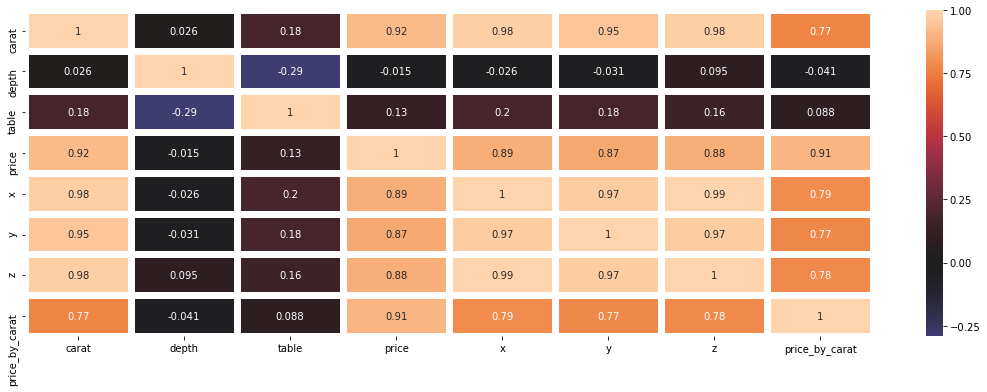

In [67]:
f, ax = plt.subplots(figsize=(19, 6))
sns.heatmap(df.corr(), annot=True, linewidths=6, center=0,ax=ax);

----
----



# **Qualitative Variables**

## **<span style="color:#0785A7"> General Description**

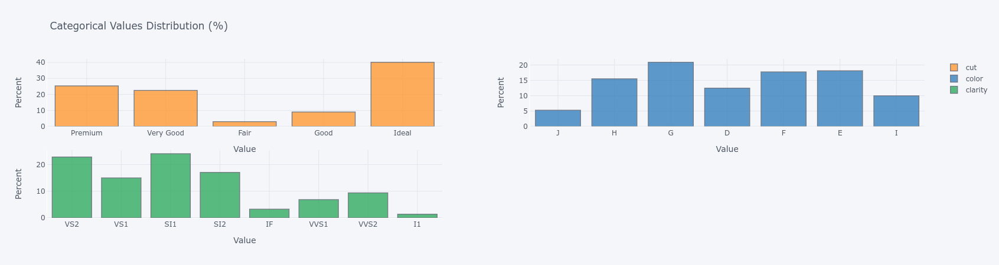

In [68]:
cat_fig = df[cat_cols].iplot(kind='hist',
         histnorm='percent',
         xTitle='Value',
         yTitle='Percent',
         title='Categorical Values Distribution (%)',
         subplots=True)


----



## **<span style="color:#0785A7"> Cut Column</span>**

Diamonds with different proportions and good polish make better use of the light, and will be bright, colorful, and scintillating.   
A beautiful diamond looks the way it does because of three optical effects: white light reflections called brightness, flashes of color called fire, and areas of light and dark called scintillation.  
Pattern is the relative size, arrangement, and contrast of bright and dark areas that result from a diamond’s internal and external reflections. There must be enough contrast between the bright and dark areas to give the pattern a crisp, sharp look.

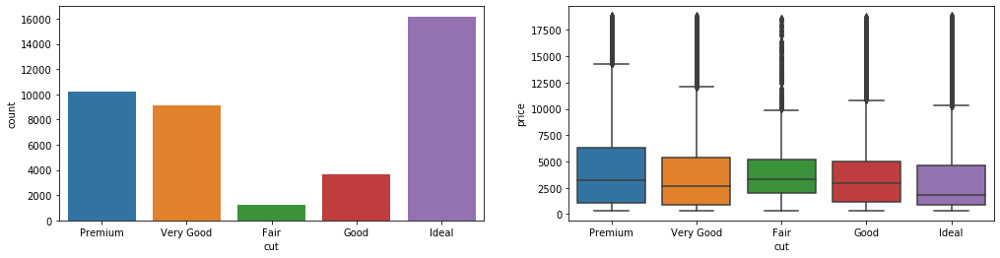

In [69]:
fig, ax = plt.subplots(1,2,figsize=(17,4))

sns.countplot(x='cut', data = df,ax=ax[0])
sns.boxplot(x="cut", y="price", data=df, ax=ax[1]);

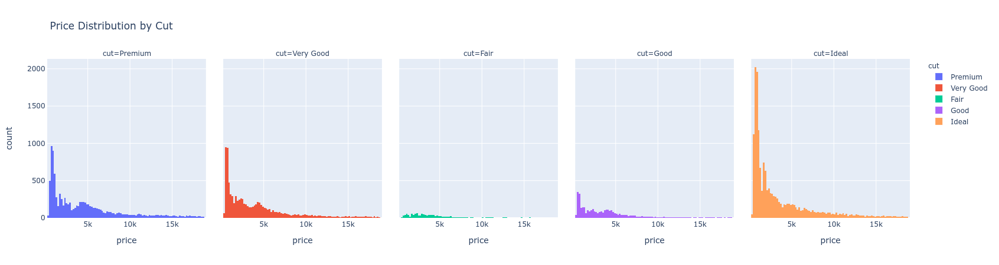

In [70]:
fig = px.histogram(df, x="price",  facet_col="cut",color='cut',title='Price Distribution by Cut')
fig.show()

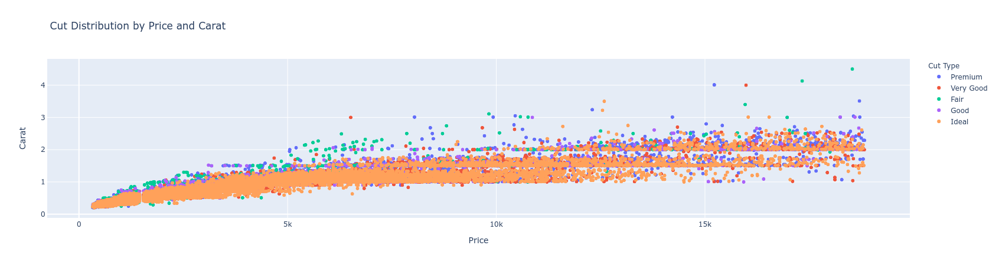

In [71]:
px.scatter(y=df["carat"], x=df["price"], color=df['cut'],title='Cut Distribution by Price and Carat',
                    labels={
                     "x": "Price",
                     "y": "Carat",
                    'color':'Cut Type'
                 })

________________

## **<span style="color:#0785A7"> Clarity Column</span>**


<img  style="float: right;" align="left" width="60%"  src="https://www.onlinediamondbuyingadvice.com/wp-content/uploads/2018/08/diamond-clarity-scale-whiteflash-768x219.png">

Among other things, blemishes include scratches and nicks on a diamond’s surface. Inclusions are generally on the inside, and some might break the surface of the stone. Sometimes, tiny diamond or other mineral crystals are trapped inside a diamond when it forms. Depending on where they’re located, they might remain after the stone has been cut and polished, and they can affect a diamond’s appearance.

Clarity characteristics might have a negative influence on a diamond’s value, but they can have positive effects as well. For one thing, they help gemologists separate diamond from imitations.

There are 11 clarity grades in the GIA clarity grading system. They are Flawless, Internally Flawless, two categories of Very, Very Slightly Included, two categories of Slightly Included, and three categories of Included.
The effect of a clarity characteristic on the clarity grade is based on its size, number, position, nature, and color or relief.

> <div class="alert alert-block alert-info">
🙋🏻‍♂️: In order to make it more clear for non diamonds experts, lets rename the categories dependig of its flawless level.
</div>

In [72]:
new_names = {'IF':'01_IF','VVS1':'02_VVS1',
             'VVS2':'03_VVS2','VS1':'04_VS1',
             'VS2':'05_VS2','SI1':'06_SI1',
             'SI2':'07_SI2','I1':'08_I1'}

df.replace({'clarity':new_names}, inplace=True)

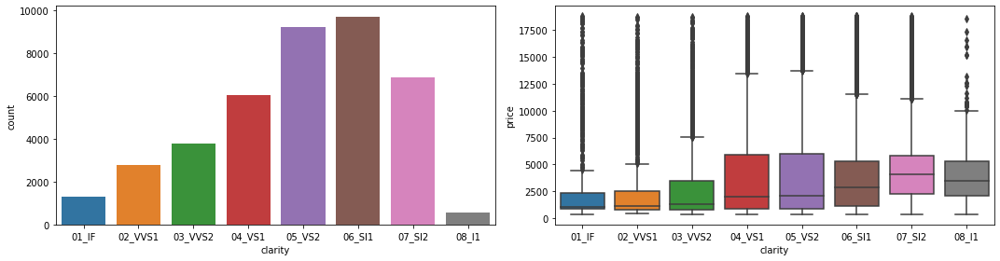

In [73]:
clartity_order_list= list(df['clarity'].unique())
clartity_order_list.sort()


fig, ax = plt.subplots(1,2,figsize=(15,4))

sns.countplot(x='clarity', data = df,ax=ax[0], order=clartity_order_list)
sns.boxplot(x="clarity", y="price", data=df, ax=ax[1],order=clartity_order_list)
plt.tight_layout()  

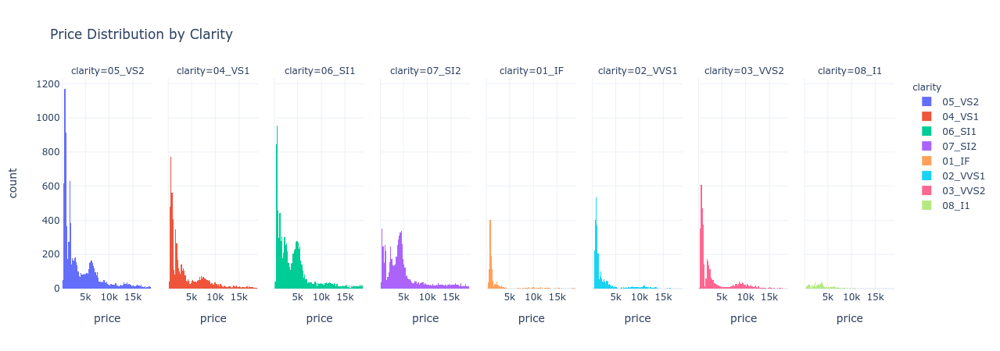

In [74]:
fig = px.histogram(df, x="price",  facet_col="clarity",color='clarity',title='Price Distribution by Clarity',template="plotly_white")
fig.show()


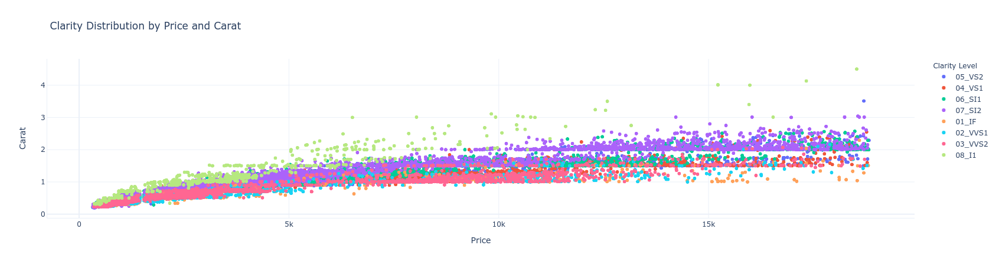

In [75]:
px.scatter(y=df["carat"], x=df["price"], color=df['clarity'], title='Clarity Distribution by Price and Carat',
                    labels={
                     "x": "Price",
                     "y": "Carat",
                      'color':'Clarity Level'
                 },template="plotly_white")


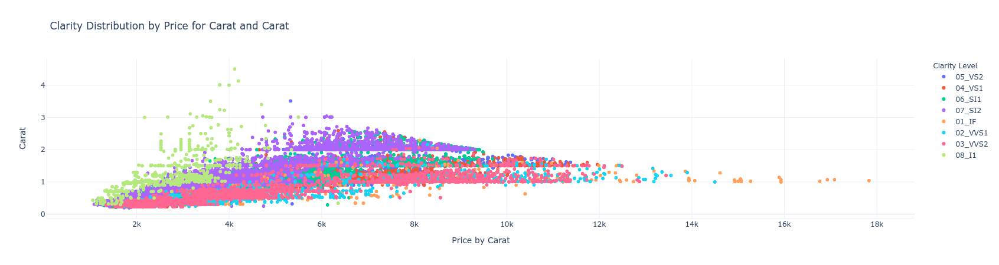

In [76]:
px.scatter(y=df["carat"], x=df["price_by_carat"], color=df['clarity'],title='Clarity Distribution by Price for Carat and Carat',
          labels={
                     "x": "Price by Carat",
                     "y": "Carat",
                      'color':'Clarity Level'
                 },template="plotly_white")

-----

## **<span style="color:#0785A7"> Color Column</span>**

<img  style="float: left;" align="left" width="60%" src="https://content.diamondnexus.com/media/wysiwyg/dn/blog/2019/may/29a/1.jpg">
Subtle differences in color can dramatically af­fect diamond value. Two diamonds of the same clarity, weight, and cut can differ in value based on color alone. Even the slightest hint of color can make a dramatic difference in value. 

Diamonds that range from colorless to light yellow and brown fall within the normal color range. Within that range, colorless diamonds are the most rare, so they’re the most valuable. They set the standard for grading and pricing other diamonds in the normal color range.  


A chemically pure and structurally perfect diamond has no hue, like a drop of pure water, and consequently, a higher value. GIA's D-to-Z color-grading system measures the degree of colorlessness by comparing a stone under controlled lighting and precise viewing conditions to masterstones of established color value.

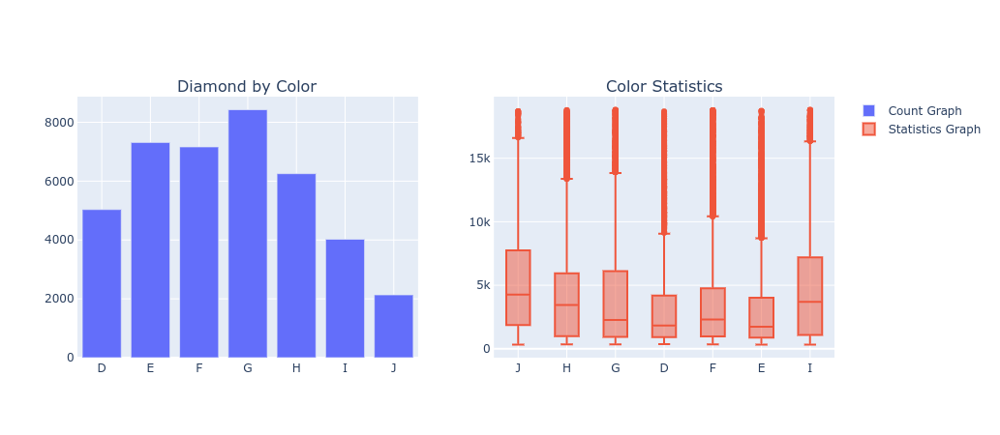

In [77]:
count_df = df[['color','x']].groupby(['color']).count().reset_index()
fig = make_subplots(rows=1, cols=2, subplot_titles=('Diamond by Color','Color Statistics'))

fig.add_trace(go.Bar(x= count_df['color'], y=count_df['x'],name='Count Graph'),row=1, col=1)
fig.add_trace(go.Box(x=df['color'], y=df['price'],name='Statistics Graph'), row=1, col=2)

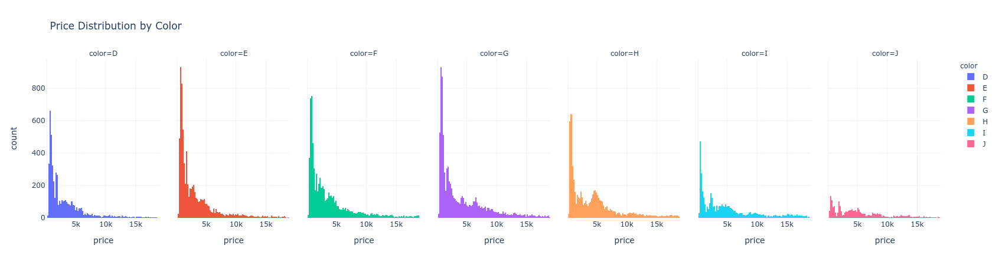

In [78]:
fig = px.histogram(df, x="price",  facet_col="color",category_orders={"color": ["D", "E", "F", "G",'H','I','J']},
                   color='color',title='Price Distribution by Color',template="plotly_white")
fig.show()

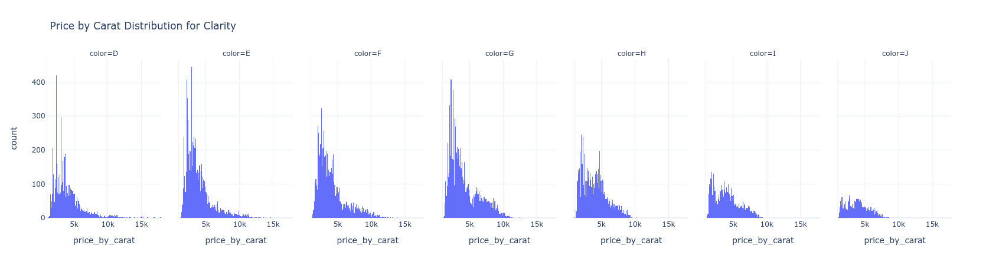

In [79]:
fig = px.histogram(df, x="price_by_carat",  facet_col="color",category_orders={"color": ["D", "E", "F", "G",'H','I','J']},
                   title='Price by Carat Distribution for Clarity',template="plotly_white")
fig.show()

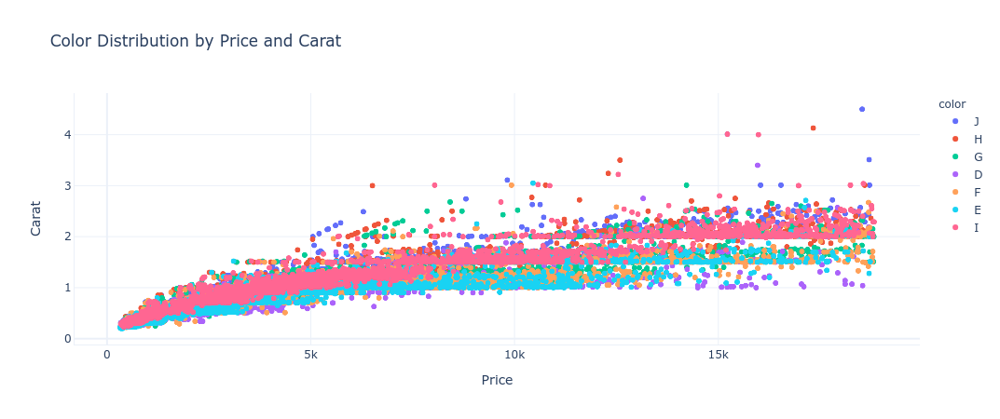

In [80]:
px.scatter(y=df["carat"], x=df["price"], color=df['color'],title='Color Distribution by Price and Carat',
          labels={
                     "x": "Price",
                     "y": "Carat",
                 },template="plotly_white")


-------------
----------

# **Qualitative Variables**

## **<span style="color:#0785A7"> General Description**

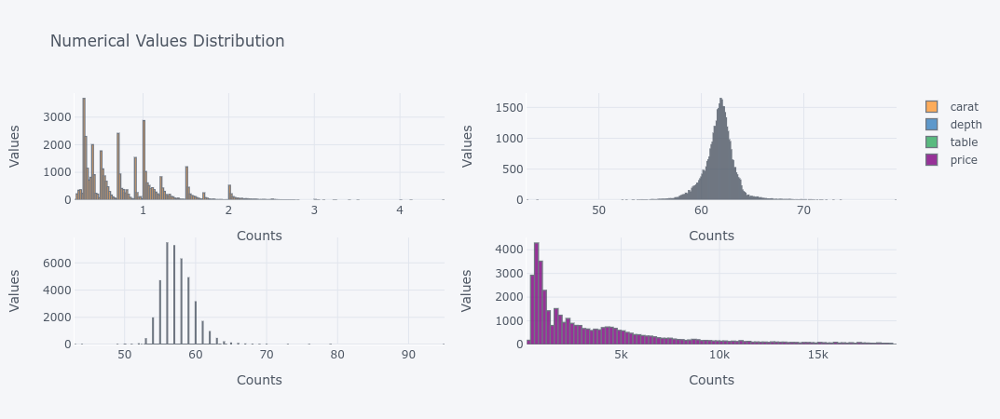

In [81]:
dimensions = ['x','y','z']
no_dimensions = [_ for _ in num_cols if _ not in dimensions]

num_fig = df[no_dimensions].iplot(kind='hist',
         xTitle='Counts',
         yTitle='Values',
         title='Numerical Values Distribution',
         subplots=True)

----

## **<span style="color:#0785A7"> Carat Column**

A metric “carat” is defined as 200 milligrams. Each carat is subdivided into 100 ‘points.’ This allows very precise measurements to the hundredth decimal place. A jeweler may describe the weight of a diamond below one carat by its ‘points’ alone. For instance, the jeweler may refer to a diamond that weighs 0.25 carats as a ‘twenty-five pointer.’ Diamond weights greater than one carat are expressed in carats and decimals. A 1.08 carat stone would be described as ‘one point oh eight carats.’

Some weights are considered “magic sizes” – half carat, three-quarter carat, and carat. Visually, there’s little difference between a 0.99 carat diamond and one that weighs a full carat. But the price differences between the two can be significant.

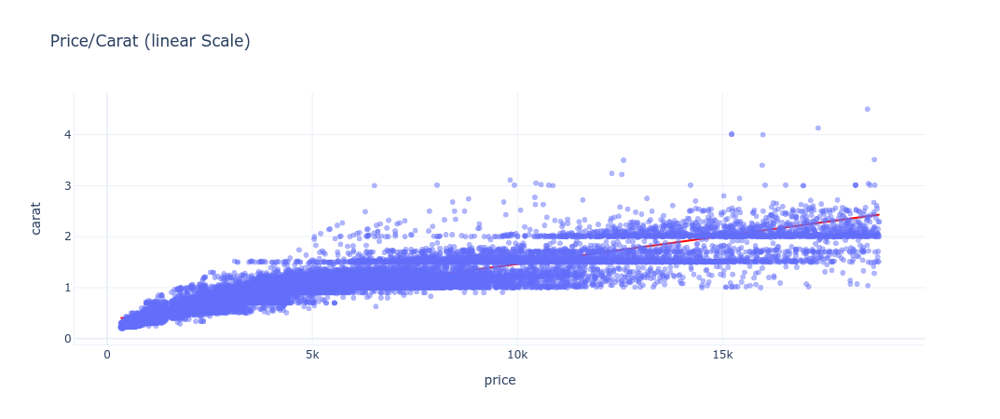

In [82]:
px.scatter(df, y="carat", x="price",
           trendline="ols",trendline_color_override='red',
           opacity=0.5, title='Price/Carat (linear Scale)',template="plotly_white")

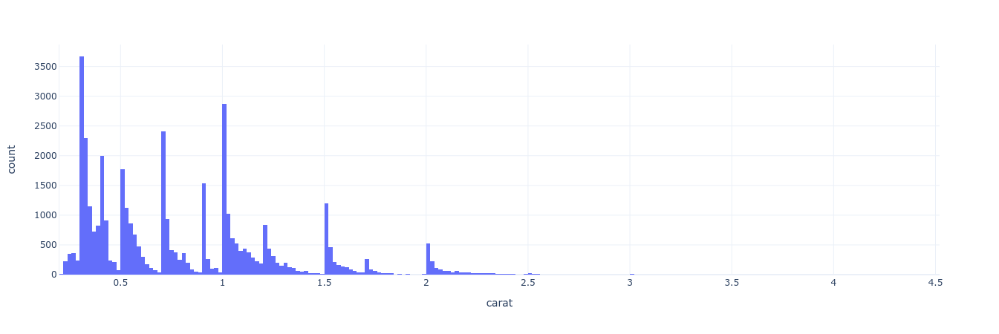

In [83]:
px.histogram(df,x="carat",template="plotly_white")

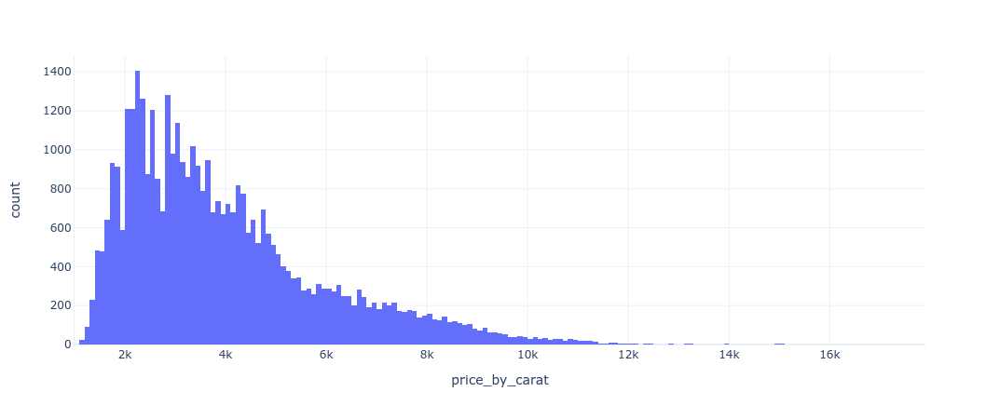

In [84]:
px.histogram(df,x="price_by_carat",template="plotly_white")

----

## **<span style="color:#0785A7"> Depth Column**

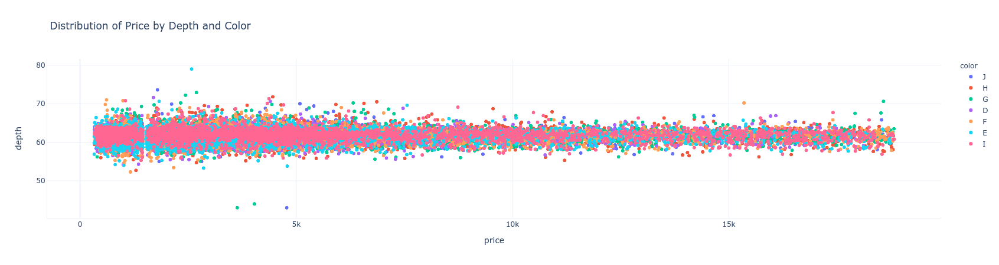

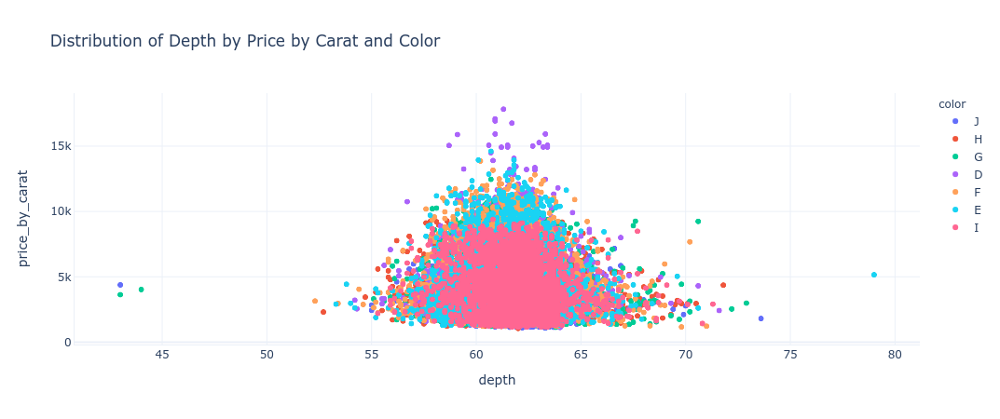

In [85]:
a=px.scatter(df, y="depth", x="price", title='Distribution of Price by Depth and Color',color='color',template="plotly_white")
b=px.scatter(df, x="depth", y="price_by_carat", title='Distribution of Depth by Price by Carat and Color',color='color',template="plotly_white")
display(a,b)

----

## **<span style="color:#0785A7"> Table  Column**

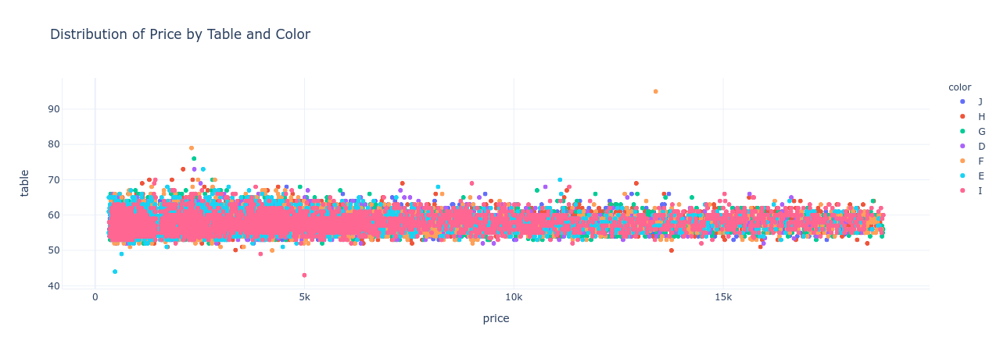

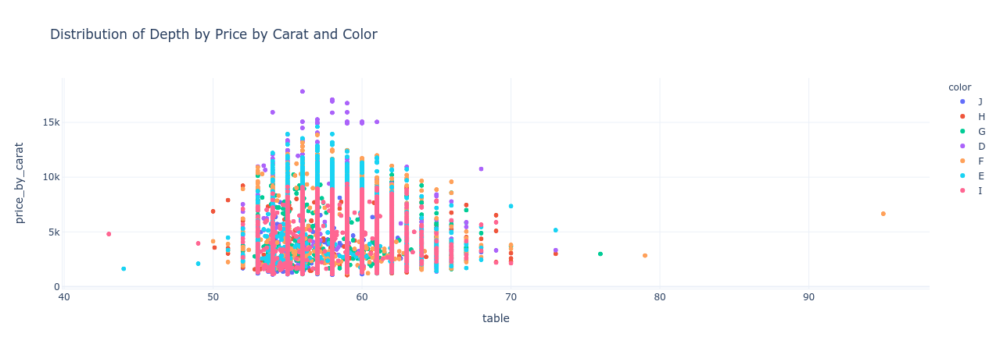

In [86]:
a=px.scatter(df, y="table", x="price", title='Distribution of Price by Table and Color',color='color',template="plotly_white")
b=px.scatter(df, x="table", y="price_by_carat", title='Distribution of Depth by Price by Carat and Color',color='color',template="plotly_white")
display(a,b)

----

## **<span style="color:#0785A7"> Price  Column**

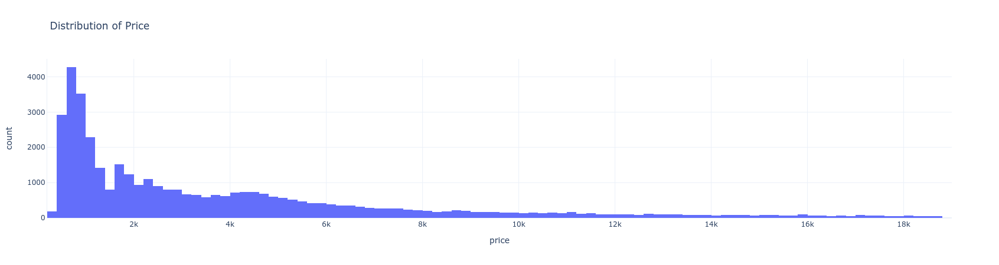

In [87]:
px.histogram(df, x="price", title='Distribution of Price',template="plotly_white")

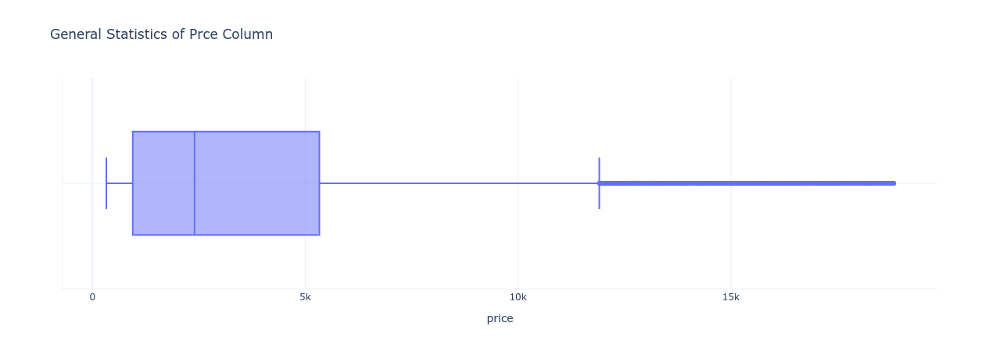

In [88]:
px.box(df, x="price", title='General Statistics of Prce Column',template="plotly_white")

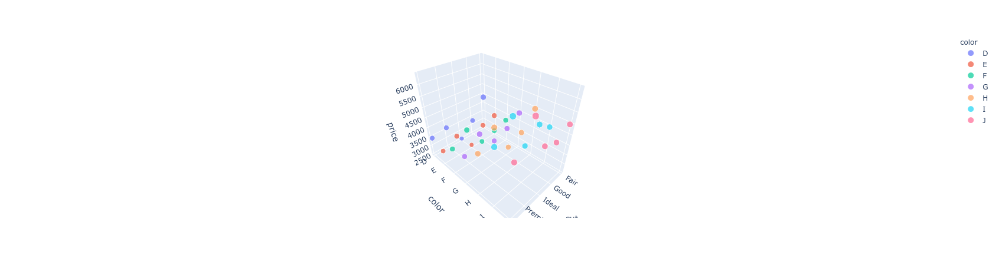

In [89]:
mean_prices = df.groupby(["cut","color"])["price"].mean().reset_index()
fig = px.scatter_3d(mean_prices, x = 'cut',y = 'color',z = 'price', color = 'color', size = 'price', hover_name = 'price') 
fig.show()

----

## **<span style="color:#0785A7"> Dimensional  Values**

In [ ]:
fig = make_subplots(rows=1, cols=3, subplot_titles=('Length','Width','Height'))
fig.add_trace(go.Box(x=df['x'],name='Length'),row=1,col=1)
fig.add_trace(go.Box(x=df['y'],name='Width'),row=1,col=2)
fig.add_trace(go.Box(x=df['z'],name='Height'),row=1,col=3)

fig.show()

In [ ]:
num_fig = df[dimensions].iplot(kind='hist',
                               xTitle='Dimension',
                               yTitle='Count',
                               title='Size Values Distribution',
                               subplots=True)


In [ ]:
fig = px.scatter_3d(df, x = 'x',y = 'y',z = 'z', color = 'color', size = 'price', hover_name = 'price') 
fig.show()

-----
----

# **Datafrme Export**

Exporting data to a CSV to make a exporatory dashboard in Tableau

In [ ]:
df.to_csv('../data/clean/diamonds_wrangled.csv', index=False)

# EXPORATORY DASHBOARD ON TABLEAU

  <p style="text-align:center;">
  <a href="https://public.tableau.com/views/Dashboard_modulo2_ironhack/Dashboard2?:language=es&:display_count=y&publish=yes&:origin=viz_share_link">
  <img style="vertical-align:middle"   align="center" width="80%"  src="../images/dashboard2.png" ></a>
  </p>